# Proyek Analisis Data: [Input Nama Dataset]
- **Nama:** Eky Ayu Veriska
- **Email:** ndutriska261207@gmail.com
- **ID Dicoding:** [Input Username]

## Menentukan Pertanyaan Bisnis

- Pertanyaan 1 : Bagaimana pola distribusi polusi udara berdasarkan lokasi geografis?
- Pertanyaan 2 : Bagaimana klasifikasi tingkat polusi udara di berbagai lokasi dan waktu?

## Import Semua Packages/Library yang Digunakan

In [91]:

import numpy as np
import pandas as pd
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import seaborn as sns
import urllib
!pip install unidecode
import unidecode
from scipy import stats
import folium
from folium.plugins import HeatMap
from folium.plugins import MarkerCluster

import altair as alt

## Data Wrangling

### Gathering Data

Insight:

1. Mengumpulkan semua tabel yang ada pada data
2. Tabel yang ada yaitu

In [5]:
## Data customers
data_customers_df = pd.read_csv('/content/customers_dataset.csv')
data_customers_df.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [6]:
# Data geolocation
data_geolocation_df = pd.read_csv('/content/geolocation_dataset.csv')
data_geolocation_df.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [7]:
# Data order item
data_order_items_df = pd.read_csv('/content/order_items_dataset.csv')
data_order_items_df.head()

,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


In [8]:
# Data order payment
data_order_payment_df = pd.read_csv('/content/order_payments_dataset.csv')
data_order_payment_df.head()

,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


In [9]:
# Data order reviews
data_order_reviews_df = pd.read_csv('/content/order_reviews_dataset.csv')
data_order_reviews_df.head()

,review_id,order_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp
0,7bc2406110b926393aa56f80a40eba40,73fc7af87114b39712e6da79b0a377eb,4,NaN,NaN,2018-01-18 00:00:00,2018-01-18 21:46:59
1,80e641a11e56f04c1ad469d5645fdfde,a548910a1c6147796b98fdf73dbeba33,5,NaN,NaN,2018-03-10 00:00:00,2018-03-11 03:05:13
2,228ce5500dc1d8e020d8d1322874b6f0,f9e4b658b201a9f2ecdecbb34bed034b,5,NaN,NaN,2018-02-17 00:00:00,2018-02-18 14:36:24
3,e64fb393e7b32834bb789ff8bb30750e,658677c97b385a9be170737859d3511b,5,NaN,Recebi bem antes do prazo estipulado.,2017-04-21 00:00:00,2017-04-21 22:02:06
4,f7c4243c7fe1938f181bec41a392bdeb,8e6bfb81e283fa7e4f11123a3fb894f1,5,NaN,Parabéns lojas lannister adorei comprar pela I...,2018-03-01 00:00:00,2018-03-02 10:26:53


In [10]:
# Data order
data_orders_df = pd.read_csv('/content/orders_dataset.csv')
data_orders_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


In [11]:
# Data produk kategori
data_product_category_df = pd.read_csv('/content/product_category_name_translation.csv')
data_product_category_df.head()

,product_category_name,product_category_name_english
0,beleza_saude,health_beauty
1,informatica_acessorios,computers_accessories
2,automotivo,auto
3,cama_mesa_banho,bed_bath_table
4,moveis_decoracao,furniture_decor


In [12]:
# Data product
data_products_df = pd.read_csv('/content/products_dataset.csv')
data_products_df.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [13]:
# Data seller
data_sellers_df = pd.read_csv('/content/sellers_dataset.csv')
data_sellers_df.head()

,seller_id,seller_zip_code_prefix,seller_city,seller_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP
1,d1b65fc7debc3361ea86b5f14c68d2e2,13844,mogi guacu,SP
2,ce3ad9de960102d0677a81f5d0bb7b2d,20031,rio de janeiro,RJ
3,c0f3eea2e14555b6faeea3dd58c1b1c3,4195,sao paulo,SP
4,51a04a8a6bdcb23deccc82b0b80742cf,12914,braganca paulista,SP


**Insight:**
- menampilkan semua tabel dan kolom yang ada pada dataset
- Tabel yang ada meliputi data customers, data geolocation, data order item, data order payments, data order reviews, data order, data product category, data poducts, dan data seller.

### Assessing Data

In [14]:
# Fungsi untuk mencetak analisis info DataFrame, duplikasi, serta nilai data
def analyze_table(df, name):
    print(f"\n=== Analisis untuk {name} ===")

    # Menampilkan informasi umum tentang DataFrame, seperti tipe data dan jumlah non-null
    print(f"\n--- Info Tabel ---\n")
    df.info()

    # Menampilkan jumlah nilai yang hilang (missing values) di setiap kolom
    print(f"\n--- Missing Value ---\n")
    print(df.isna().sum())

    # Menampilkan jumlah baris duplikat dalam DataFrame
    print(f"\n--- Duplikat ---\n")
    print(df.duplicated().sum())

    # Menampilkan ringkasan statistik dari DataFrame, termasuk nilai unik, rata-rata, min, max, dll.
    print(f"\n--- Deskripsi Tabel ---\n")
    print(df.describe(include="all"))


# Fungsi untuk menganalisis beberapa DataFrame sekaligus
def analyze_dataframes(dataframes):
    for name, df in dataframes.items():
        analyze_table(df, name)  # Memanggil analyze_table untuk setiap DataFrame dalam dictionary


# Dictionary yang berisi semua DataFrame yang akan dianalisis
dataframes = {
    "data_customers_df": data_customers_df,  # Data pelanggan
    "data_geolocation_df": data_geolocation_df,  # Data lokasi geografis
    "data_order_items_df": data_order_items_df,  # Data item dalam pesanan
    "data_order_payment_df": data_order_payment_df,  # Data pembayaran pesanan
    "data_order_reviews_df": data_order_reviews_df,  # Data ulasan pelanggan
    "data_orders_df": data_orders_df,
    } #

    # Panggil fungsi analisis
analyze_dataframes(dataframes)




=== Analisis untuk data_customers_df ===

--- Info Tabel ---

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99441 entries, 0 to 99440
Data columns (total 5 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   customer_id               99441 non-null  object
 1   customer_unique_id        99441 non-null  object
 2   customer_zip_code_prefix  99441 non-null  int64 
 3   customer_city             99441 non-null  object
 4   customer_state            99441 non-null  object
dtypes: int64(1), object(4)
memory usage: 3.8+ MB

--- Missing Value ---

customer_id                 0
customer_unique_id          0
customer_zip_code_prefix    0
customer_city               0
customer_state              0
dtype: int64

--- Duplikat ---

0

--- Deskripsi Tabel ---

                             customer_id                customer_unique_id  \
count                              99441                             99441   
unique     

**Insight:**
- Data customers → tidak terdapat data yang perlu dibersihkan
- Data geolocation → masih terdapat duplikasi data
- Data order items → kolom shipping_limit_date seharusnya memiliki tipe - - data datetime, bukan object
- Data order payments → tidak ada masalah dalam data
- Data order reviews → terdapat missing value pada kolom review_comment_title & review_comment_message, serta tipe data date masih - dalam format object
- Data orders → tipe data date belum dikonversi ke datetime
- Data product category → tidak ditemukan kendala pada data
- Data product → hampir semua kolom memiliki missing value kecuali product_id
- Data sellers → data sudah bersih tanpa kendala

### Cleaning Data

In [15]:
# membersihkandata geolocation
data_geolocation_df.drop_duplicates(inplace=True)
# mengecek apakah masih ada data yang terduplikasi
data_geolocation_df.duplicated().sum()

0

In [16]:
# Membersihkan data order items
# Mengubah tipe data shipping_limit_date menjadi datetime
data_order_items_df['shipping_limit_date'] = pd.to_datetime(data_order_items_df['shipping_limit_date'])

# Memastikan perubahan tipe data berhasil
data_order_items_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 112650 entries, 0 to 112649
Data columns (total 7 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   order_id             112650 non-null  object        
 1   order_item_id        112650 non-null  int64         
 2   product_id           112650 non-null  object        
 3   seller_id            112650 non-null  object        
 4   shipping_limit_date  112650 non-null  datetime64[ns]
 5   price                112650 non-null  float64       
 6   freight_value        112650 non-null  float64       
dtypes: datetime64[ns](1), float64(2), int64(1), object(3)
memory usage: 6.0+ MB


In [17]:
# Membersihkan data order reviews
# Menghapus kolom yang memiliki missing values
data_order_reviews_df.drop(columns=['review_comment_title', 'review_comment_message',
                               'review_answer_timestamp'], inplace=True)


In [18]:
# Mengecek jumlah missing values pada data order reviews
data_order_reviews_df.isnull().sum()


,0
review_id,0
order_id,0
review_score,0
review_creation_date,0


In [19]:
# Mengonversi kolom review_creation_date ke tipe data datetime
data_order_reviews_df['review_creation_date'] = pd.to_datetime(data_order_reviews_df['review_creation_date'])


In [20]:
# Menampilkan informasi struktur data order reviews setelah pembersihan
data_order_reviews_df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99224 entries, 0 to 99223
Data columns (total 4 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   review_id             99224 non-null  object        
 1   order_id              99224 non-null  object        
 2   review_score          99224 non-null  int64         
 3   review_creation_date  99224 non-null  datetime64[ns]
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 3.0+ MB


In [21]:
# Membersihkan data orders
# Mengubah tipe data kolom tanggal menjadi datetime
data_orders_df['order_purchase_timestamp'] = pd.to_datetime(data_orders_df['order_purchase_timestamp'])
data_orders_df['order_approved_at'] = pd.to_datetime(data_orders_df['order_approved_at'])
data_orders_df['order_delivered_carrier_date'] = pd.to_datetime(data_orders_df['order_delivered_carrier_date'])
data_orders_df['order_delivered_customer_date'] = pd.to_datetime(data_orders_df['order_delivered_customer_date'])
data_orders_df['order_estimated_delivery_date'] = pd.to_datetime(data_orders_df['order_estimated_delivery_date'])

# Menghapus baris dengan missing values
data_orders_df.dropna(inplace=True)

# Menampilkan informasi struktur data setelah pembersihan
data_orders_df.info()


<class 'pandas.core.frame.DataFrame'>
Index: 96461 entries, 0 to 99440
Data columns (total 8 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   order_id                       96461 non-null  object        
 1   customer_id                    96461 non-null  object        
 2   order_status                   96461 non-null  object        
 3   order_purchase_timestamp       96461 non-null  datetime64[ns]
 4   order_approved_at              96461 non-null  datetime64[ns]
 5   order_delivered_carrier_date   96461 non-null  datetime64[ns]
 6   order_delivered_customer_date  96461 non-null  datetime64[ns]
 7   order_estimated_delivery_date  96461 non-null  datetime64[ns]
dtypes: datetime64[ns](5), object(3)
memory usage: 6.6+ MB


In [22]:
# Menghapus 3 kolom yang paling tidak berguna dari data produk
columns_to_drop = ['product_name_lenght', 'product_description_lenght', 'product_weight_g']

data_products_df.drop(columns=columns_to_drop, inplace=True)


**Insight:**
- Geolocation: Data duplikat telah dihilangkan menggunakan drop_duplicates(), sehingga dataset lebih bersih dan tidak mengandung entri ganda.
- Order Items: Kolom shipping_limit_date sudah dikonversi ke tipe datetime, memudahkan analisis terkait estimasi waktu pengiriman.
- Products: Beberapa kolom yang kurang berpengaruh (seperti ukuran dan berat produk) telah dihapus untuk menyederhanakan dataset.
- Order Reviews: Kolom yang memiliki banyak nilai kosong, seperti review_comment_title, telah dihapus agar analisis ulasan lebih fokus.
- Orders: Seluruh kolom dengan format tanggal sudah dikonversi ke datetime, dan data yang tidak lengkap telah dihapus untuk meningkatkan kualitas analisis.

Langkah ini dilakukan untuk memastikan dataset lebih terstruktur dan siap digunakan dalam analisis lebih lanjut.

## Exploratory Data Analysis (EDA)

### Explore ...

In [23]:
data_products_df.sample(20)

,product_id,product_category_name,product_photos_qty,product_length_cm,product_height_cm,product_width_cm
32450,ac73a545907ecae37cf969833e3a7959,utilidades_domesticas,4.0,20.0,15.0,25.0
10255,2fab6789523833dd6179314d5c7da56f,moveis_decoracao,2.0,16.0,26.0,20.0
16941,0a9bdadab17a9b0f258f64d11a0adf7b,moveis_decoracao,1.0,53.0,48.0,26.0
26454,43838436d448f6775af2718e0de8dc50,cama_mesa_banho,3.0,56.0,36.0,37.0
15380,f48b7a74ac33f4a15d4dcf0b549ec7a8,automotivo,5.0,78.0,4.0,47.0
12658,26d7ac00b95e35c6592f0c0b289179f6,moveis_decoracao,1.0,24.0,2.0,24.0
13264,ce2c8e8fb6241fbc08bbed5a8c6e92cc,esporte_lazer,4.0,20.0,10.0,15.0
30444,73e11faf1b0eecfd43a0e0fa4dcd7954,cama_mesa_banho,1.0,42.0,16.0,34.0
17688,856d9d588dc3c29333a36027f22e2091,artigos_de_natal,1.0,16.0,16.0,16.0
4130,0c761b0e33d708e6a3694a94ac4b82c4,beleza_saude,1.0,35.0,10.0,18.0


In [24]:
data_products_df.describe(include="all")

,product_id,product_category_name,product_photos_qty,product_length_cm,product_height_cm,product_width_cm
count,32951,32341,32341.000000,32949.000000,32949.000000,32949.000000
unique,32951,73,NaN,NaN,NaN,NaN
top,1e9e8ef04dbcff4541ed26657ea517e5,cama_mesa_banho,NaN,NaN,NaN,NaN
freq,1,3029,NaN,NaN,NaN,NaN
mean,NaN,NaN,2.188986,30.815078,16.937661,23.196728
std,NaN,NaN,1.736766,16.914458,13.637554,12.079047
min,NaN,NaN,1.000000,7.000000,2.000000,6.000000
25%,NaN,NaN,1.000000,18.000000,8.000000,15.000000
50%,NaN,NaN,1.000000,25.000000,13.000000,20.000000
75%,NaN,NaN,3.000000,38.000000,21.000000,30.000000


In [25]:
## Mengelompokkan berdasarkan kategori produk dan menghitung jumlah produk unik
data_products_df.groupby(by="product_category_name")["product_id"].nunique().sort_values(ascending=False)

# Kategori produk dengan jumlah unik terbanyak adalah "cama_mesa_banho" (3.029 produk),
# menunjukkan bahwa kategori ini memiliki banyak variasi produk.
# Sedangkan kategori dengan jumlah unik paling sedikit adalah "cds_dvds_musicais" (1 produk),
# menandakan keterbatasan variasi dalam kategori tersebut.


,product_id
product_category_name,
cama_mesa_banho,3029
esporte_lazer,2867
moveis_decoracao,2657
beleza_saude,2444
utilidades_domesticas,2335
...,...
casa_conforto_2,5
fashion_roupa_infanto_juvenil,5
pc_gamer,3


In [26]:
data_products_df.groupby(by="product_photos_qty").product_id.nunique().sort_values(ascending=False)

# Mengelompokkan data berdasarkan jumlah foto produk
# Menghitung jumlah produk unik dalam setiap kelompok
# Mengurutkan hasil dari yang terbanyak ke yang paling sedikit


,product_id
product_photos_qty,
1.0,16489
2.0,6263
3.0,3860
4.0,2428
5.0,1484
6.0,968
7.0,343
8.0,192
9.0,105


In [27]:
# Menggabungkan products_df & order_items_df
# Menggunakan left join untuk mempertahankan semua data produk meskipun tidak ada di order_items
data_product_orders_df = pd.merge(
    left=data_products_df,
    right=data_order_items_df,
    how="left",
    left_on="product_id",
    right_on="product_id"
)

# Menampilkan 10 data pertama setelah penggabungan
data_product_orders_df.head(10)


,product_id,product_category_name,product_photos_qty,product_length_cm,product_height_cm,product_width_cm,order_id,order_item_id,seller_id,shipping_limit_date,price,freight_value
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,1.0,16.0,10.0,14.0,e17e4f88e31525f7deef66779844ddce,1,5670f4db5b62c43d542e1b2d56b0cf7c,2018-04-30 17:33:54,10.91,7.39
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,1.0,30.0,18.0,20.0,5236307716393b7114b53ee991f36956,1,b561927807645834b59ef0d16ba55a24,2018-02-06 19:11:15,248.00,17.99
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,1.0,18.0,9.0,15.0,01f66e58769f84129811d43eefd187fb,1,7b07b3c7487f0ea825fc6df75abd658b,2018-07-11 21:30:20,79.80,7.82
3,cef67bcfe19066a932b7673e239eb23d,bebes,1.0,26.0,4.0,26.0,143d00a4f2dde4e0364ee1821577adb3,1,c510bc1718f0f2961eaa42a23330681a,2018-08-07 09:10:13,112.30,9.54
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,4.0,20.0,17.0,13.0,86cafb8794cb99a9b1b77fc8e48fbbbb,1,0be8ff43f22e456b4e0371b2245e4d01,2018-04-17 01:30:23,37.90,8.29
5,41d3672d4792049fa1779bb35283ed13,instrumentos_musicais,1.0,38.0,5.0,11.0,c214058828b43a44f352b56ff2d5c0a5,1,ce248b21cb2adc36282ede306b7660e5,2018-03-19 15:48:29,45.87,19.95
6,732bd381ad09e530fe0a5f457d81becb,cool_stuff,4.0,70.0,24.0,44.0,9632facd8bd95315d63a23bf616d85b0,1,8b8cfc8305aa441e4239358c9f6f2485,2018-01-18 12:39:24,958.00,27.76
7,732bd381ad09e530fe0a5f457d81becb,cool_stuff,4.0,70.0,24.0,44.0,c6343db6c1801f9c3301166f02931116,1,8b8cfc8305aa441e4239358c9f6f2485,2017-12-11 11:30:51,968.00,44.30
8,2548af3e6e77a690cf3eb6368e9ab61e,moveis_decoracao,2.0,40.0,8.0,40.0,6ecf7023e8dd4ec8b08746c35b9fcb60,3,95f83f51203c626648c875dd41874c7f,2017-11-30 16:31:00,9.99,16.02
9,2548af3e6e77a690cf3eb6368e9ab61e,moveis_decoracao,2.0,40.0,8.0,40.0,6ecf7023e8dd4ec8b08746c35b9fcb60,4,95f83f51203c626648c875dd41874c7f,2017-11-30 16:31:00,9.99,16.02


In [28]:
# Menggabungkan jumlah foto produk dengan dimensi produk
product_photos_dimensions_df = data_products_df[[ "product_photos_qty", "product_length_cm", "product_height_cm", "product_width_cm"]]

# Menampilkan 5 data pertama
product_photos_dimensions_df.head(10)


,product_photos_qty,product_length_cm,product_height_cm,product_width_cm
0,1.0,16.0,10.0,14.0
1,1.0,30.0,18.0,20.0
2,1.0,18.0,9.0,15.0
3,1.0,26.0,4.0,26.0
4,4.0,20.0,17.0,13.0
5,1.0,38.0,5.0,11.0
6,4.0,70.0,24.0,44.0
7,2.0,40.0,8.0,40.0
8,1.0,27.0,13.0,17.0
9,1.0,17.0,10.0,12.0


In [29]:
# Mengelompokkan jumlah produk berdasarkan jumlah foto yang dimiliki
data_products_df.groupby(by="product_photos_qty").product_id.nunique().sort_values(ascending=False)


,product_id
product_photos_qty,
1.0,16489
2.0,6263
3.0,3860
4.0,2428
5.0,1484
6.0,968
7.0,343
8.0,192
9.0,105


In [30]:
# Mengelompokkan jumlah foto produk dan melakukan agregasi pada dimensi produk
data_products_df.groupby(by="product_photos_qty").agg({
    "product_id": "nunique",  # Menghitung jumlah produk unik
    "product_length_cm": ["min", "max"],  # Panjang produk minimum & maksimum
    "product_height_cm": ["min", "max"],  # Tinggi produk minimum & maksimum
    "product_width_cm": ["min", "max"]  # Lebar produk minimum & maksimum
})


product_id product_length_cm        product_height_cm  \
                      nunique               min    max               min   
product_photos_qty                                                         
1.0                     16489               7.0  105.0               2.0   
2.0                      6263               8.0  105.0               2.0   
3.0                      3860              10.0  105.0               2.0   
4.0                      2428              14.0  105.0               2.0   
5.0                      1484              12.0  105.0               2.0   
6.0                       968              11.0  105.0               2.0   
7.0                       343              16.0  103.0               2.0   
8.0                       192              14.0  105.0               2.0   
9.0                       105              16.0  105.0               2.0   
10.0                       95              16.0  100.0               2.0   
11.0                       46              16.0   70.0               3.0   
12.0                       35              16.0   49.0               3.0   
13.0                        9              16.0   45.0               3.0   
14.0                        5              20.0   33.0               8.0   
15.0                        8              18.0   47.0              10.0   
17.0                        7              21.0   33.0              17.0   
18.0                        2              33.0   33.0              30.0   
19.0                        1              32.0   32.0              49.0   
20.0                        1              32.0   32.0              49.0   

                          product_width_cm         
                      max              min    max  
product_photos_qty                                 
1.0                 105.0              7.0  105.0  
2.0                 105.0              6.0  105.0  
3.0                 105.0              7.0  118.0  
4.0                 105.0              7.0  105.0  
5.0                 105.0             11.0   97.0  
6.0                 104.0              6.0   90.0  
7.0                 100.0             11.0   70.0  
8.0                  95.0             11.0   90.0  
9.0                  61.0             11.0   67.0  
10.0                 78.0             11.0   60.0  
11.0                 31.0             11.0   55.0  
12.0                 65.0             11.0   40.0  
13.0                 23.0             11.0   45.0  
14.0                 30.0             20.0   44.0  
15.0                 74.0             15.0   47.0  
17.0                 30.0             30.0   44.0  
18.0                 30.0             44.0   44.0  
19.0                 49.0             34.0   34.0  
20.0                 49.0             34.0   34.0

In [31]:
data_customers_df.describe(include="all")

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
count,99441,99441,99441.000000,99441,99441
unique,99441,96096,NaN,4119,27
top,06b8999e2fba1a1fbc88172c00ba8bc7,8d50f5eadf50201ccdcedfb9e2ac8455,NaN,sao paulo,SP
freq,1,17,NaN,15540,41746
mean,NaN,NaN,35137.474583,NaN,NaN
std,NaN,NaN,29797.938996,NaN,NaN
min,NaN,NaN,1003.000000,NaN,NaN
25%,NaN,NaN,11347.000000,NaN,NaN
50%,NaN,NaN,24416.000000,NaN,NaN
75%,NaN,NaN,58900.000000,NaN,NaN


In [32]:
# Menggabungkan data_customers_df dengan data_orders_df menggunakan customer_id
data_customer_df = pd.merge(
    left=data_customers_df,
    right=data_orders_df,
    how="left",
    on="customer_id"  # Menggunakan customer_id sebagai kunci gabungan
)

# Menampilkan 5 data pertama
data_customer_df.head()


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,00e7ee1b050b8499577073aeb2a297a1,delivered,2017-05-16 15:05:35,2017-05-16 15:22:12,2017-05-23 10:47:57,2017-05-25 10:35:35,2017-06-05
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,29150127e6685892b6eab3eec79f59c7,delivered,2018-01-12 20:48:24,2018-01-12 20:58:32,2018-01-15 17:14:59,2018-01-29 12:41:19,2018-02-06
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,b2059ed67ce144a36e2aa97d2c9e9ad2,delivered,2018-05-19 16:07:45,2018-05-20 16:19:10,2018-06-11 14:31:00,2018-06-14 17:58:51,2018-06-13
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,951670f92359f4fe4a63112aa7306eba,delivered,2018-03-13 16:06:38,2018-03-13 17:29:19,2018-03-27 23:22:42,2018-03-28 16:04:25,2018-04-10
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,6b7d50bd145f6fc7f33cebabd7e49d0f,delivered,2018-07-29 09:51:30,2018-07-29 10:10:09,2018-07-30 15:16:00,2018-08-09 20:55:48,2018-08-15


In [33]:
# Menggabungkan data produk dengan data item pesanan berdasarkan product_id
data_product_details_df = pd.merge(
    left=data_products_df,
    right=data_order_items_df,
    how="left",
    on="product_id"  # Menggunakan product_id sebagai kunci penghubung
)

# Menampilkan 5 data pertama
data_product_details_df.head()


,product_id,product_category_name,product_photos_qty,product_length_cm,product_height_cm,product_width_cm,order_id,order_item_id,seller_id,shipping_limit_date,price,freight_value
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,1.0,16.0,10.0,14.0,e17e4f88e31525f7deef66779844ddce,1,5670f4db5b62c43d542e1b2d56b0cf7c,2018-04-30 17:33:54,10.91,7.39
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,1.0,30.0,18.0,20.0,5236307716393b7114b53ee991f36956,1,b561927807645834b59ef0d16ba55a24,2018-02-06 19:11:15,248.00,17.99
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,1.0,18.0,9.0,15.0,01f66e58769f84129811d43eefd187fb,1,7b07b3c7487f0ea825fc6df75abd658b,2018-07-11 21:30:20,79.80,7.82
3,cef67bcfe19066a932b7673e239eb23d,bebes,1.0,26.0,4.0,26.0,143d00a4f2dde4e0364ee1821577adb3,1,c510bc1718f0f2961eaa42a23330681a,2018-08-07 09:10:13,112.30,9.54
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,4.0,20.0,17.0,13.0,86cafb8794cb99a9b1b77fc8e48fbbbb,1,0be8ff43f22e456b4e0371b2245e4d01,2018-04-17 01:30:23,37.90,8.29


In [34]:
# Menggabungkan data_products_df dengan data_product_orders_df menggunakan product_id sebagai kunci penghubung
data_products_df = pd.merge(
    left=data_products_df,  # Data utama yang akan dipertahankan semua datanya
    right=data_product_orders_df,  # Data tambahan yang ingin digabungkan
    how="left",  # Menggunakan left join agar semua data dari data_products_df tetap ada
    on="product_id"  # Gunakan product_id sebagai kunci untuk menggabungkan kedua DataFrame
)

# Menampilkan 5 baris pertama hasil penggabungan untuk memastikan hasilnya sesuai
data_products_df.head()


,product_id,product_category_name_x,product_photos_qty_x,product_length_cm_x,product_height_cm_x,product_width_cm_x,product_category_name_y,product_photos_qty_y,product_length_cm_y,product_height_cm_y,product_width_cm_y,order_id,order_item_id,seller_id,shipping_limit_date,price,freight_value
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,1.0,16.0,10.0,14.0,perfumaria,1.0,16.0,10.0,14.0,e17e4f88e31525f7deef66779844ddce,1,5670f4db5b62c43d542e1b2d56b0cf7c,2018-04-30 17:33:54,10.91,7.39
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,1.0,30.0,18.0,20.0,artes,1.0,30.0,18.0,20.0,5236307716393b7114b53ee991f36956,1,b561927807645834b59ef0d16ba55a24,2018-02-06 19:11:15,248.00,17.99
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,1.0,18.0,9.0,15.0,esporte_lazer,1.0,18.0,9.0,15.0,01f66e58769f84129811d43eefd187fb,1,7b07b3c7487f0ea825fc6df75abd658b,2018-07-11 21:30:20,79.80,7.82
3,cef67bcfe19066a932b7673e239eb23d,bebes,1.0,26.0,4.0,26.0,bebes,1.0,26.0,4.0,26.0,143d00a4f2dde4e0364ee1821577adb3,1,c510bc1718f0f2961eaa42a23330681a,2018-08-07 09:10:13,112.30,9.54
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,4.0,20.0,17.0,13.0,utilidades_domesticas,4.0,20.0,17.0,13.0,86cafb8794cb99a9b1b77fc8e48fbbbb,1,0be8ff43f22e456b4e0371b2245e4d01,2018-04-17 01:30:23,37.90,8.29


In [37]:
data_orders_df.sample(10)


,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
29941,d79d241a5cf403c982409819c8aaaa98,f48bb6ae97f067d5e7341e5de79c70a3,delivered,2017-10-20 11:27:43,2017-10-24 06:35:09,2017-10-24 17:57:50,2017-10-26 20:49:58,2017-11-08
54944,f104090fcd96c0b2ca8f9d818127ccf5,fb52eb341179dfe943f35912b96505e8,delivered,2018-02-02 14:13:03,2018-02-02 14:51:57,2018-02-08 23:08:39,2018-02-14 14:06:20,2018-03-02
311,4906eeadde5f70b308c20c4a8f20be02,4e7656e34357b93f14b40c6400ca3f6e,delivered,2017-12-08 04:45:26,2017-12-12 03:50:30,2017-12-12 17:43:21,2018-01-09 18:04:58,2018-01-03
74098,8b5ac3bd97ae763bf44b554c2933ca72,337be0b47c3b0cb04b314503067a2aaf,delivered,2017-04-29 09:03:45,2017-04-29 09:15:17,2017-05-24 11:25:49,2017-05-31 13:42:10,2017-07-05
21463,0449fc8e83f3042e2e415a2bc3f2a424,e21d7ebfedc67c1a6678e37c53a78a4d,delivered,2018-04-20 08:36:13,2018-04-20 08:52:48,2018-04-20 18:52:41,2018-04-27 16:38:37,2018-05-18
30009,e1041ca455e08b097d279568b13b22a1,f1ebe3628f15f8a83b0b380accafb017,delivered,2017-03-09 11:09:46,2017-03-09 11:09:46,2017-03-10 14:32:58,2017-03-20 16:42:28,2017-03-30
23353,55d4d9c0f7de603b836a906fa3dc4d91,92e467b22526e35c020e4b58b03ba8f3,delivered,2018-01-31 13:14:45,2018-01-31 14:26:37,2018-02-01 20:47:36,2018-02-06 19:22:46,2018-02-23
10806,ce7be9c906c372368c7786881d6a6842,688d5dc30311f2b5c9deb3776842896a,delivered,2018-01-29 14:39:12,2018-01-29 14:51:18,2018-01-30 14:15:15,2018-02-08 16:26:46,2018-03-01
85628,6c27984bddb654e222cd1b9a238d2e74,722dd6e14d2f43121531d24edae4e1e7,delivered,2018-05-17 16:38:34,2018-05-18 04:54:43,2018-05-18 13:51:00,2018-06-04 15:51:46,2018-06-11
96091,e22cc707086f54199ddd7ce4b79db163,ea29946c5fc530b67866c9cf8bf12aa2,delivered,2017-12-11 22:29:46,2017-12-12 00:14:16,2017-12-12 21:36:53,2017-12-18 21:32:20,2018-01-04


In [38]:
delivery_time = data_orders_df["order_delivered_customer_date"] - data_orders_df["order_delivered_carrier_date"]
delivery_time = delivery_time.apply(lambda x: x.total_seconds())
data_orders_df["delivery_time"] = round(delivery_time/86400)

In [39]:
# menggambil sampel data
data_geolocation_df.sample(10)


,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
491116,25926,-22.706326,-43.150487,mage,RJ
402784,19880,-22.747481,-50.385049,candido mota,SP
387854,18275,-23.356972,-47.854795,tatuí,SP
451804,22621,-23.012518,-43.305175,rio de janeiro,RJ
49855,3223,-23.591407,-46.558520,sao paulo,SP
367489,17052,-22.335716,-49.088448,bauru,SP
376076,17700,-21.801233,-50.865783,osvaldo cruz,SP
114623,5085,-23.528165,-46.724675,sao paulo,SP
112728,4937,-23.683789,-46.760864,sao paulo,SP
395725,18710,-23.140849,-49.058857,arandu,SP


In [42]:
# menggambil sampel data
data_customers_df.sample(10)


,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
92253,603e5fb8eb576575546d8880846aaac6,fde5dcb254167dcbac0ba786916bdf75,2082,sao paulo,SP
59000,32224721a96f2124f81c29c03cb00f9f,e627a946f4e539a31e1743a053c865d2,24723,sao goncalo,RJ
47529,deeec572358e558412acc3e2386a35e4,3c2cd533f2af84b6cb81b8b97be89988,3131,sao paulo,SP
35898,781aba8df3b1bb0efe7657a98f7412da,d264b217560e5f1bb611fa4a00580c61,36900,manhuacu,MG
61853,29250bf22b33e1aaa5b19b78e7593afb,511b4bb3561723c152c7b823cdf9eb44,33400,lagoa santa,MG
71325,72ca022d5f986cbeba818c19e6cd2f75,66908d0dec4e384b916f137d8a31ce73,13073,campinas,SP
69296,623edf812b63d58f3d26804f200f4aab,c8e559a002528dcae0cdf29dab6f1e3e,22713,rio de janeiro,RJ
5535,e0ac205752138fe132560b033be7f9d4,661d61e36af76f870eb3ad6c7b8199ea,95780,montenegro,RS
25835,e18f5bbc77c09e732b68e3908e393ff1,231affe4b855d6636825f11617b621dd,37564,borda da mata,MG
93988,ae2637018dbd6fb499db07816dcce0b8,32b21622c8c06acf5568104e449e2617,70673,brasilia,DF


In [43]:
# menggambil sampel data
data_order_payment_df.sample(10)


,order_id,payment_sequential,payment_type,payment_installments,payment_value
35141,aa3a8549b44bdf1c12309c0f439f9964,1,credit_card,3,35.00
43275,7a3b1ac379d3a8db0d2a257e0148d133,1,boleto,1,44.83
25865,423e9363ad13622c0deb3615c736eb0c,1,boleto,1,213.38
74169,f1f4f8ff819c5510c061520a5485a6b1,1,credit_card,4,78.19
28550,5409cdf5d7f44a620466f80570fade10,1,credit_card,1,57.51
1663,a1b499a72aca650e451a357f1eb45c03,1,credit_card,1,59.56
46512,84960d31af78367051a7134bf7b64f29,1,credit_card,4,90.18
65366,02a001cb5f40b1fee4f0375c89cce463,1,boleto,1,97.44
20741,2ec585cc6e3630ad3ad3734da342e94e,1,credit_card,4,41.84
48962,4354f0ac2e0b3501ff31c4752424e51a,1,credit_card,5,803.68


In [40]:
all_data = pd.merge(
    left=data_sellers_df,
    right=data_geolocation_df,
    how="left",
    left_on="seller_zip_code_prefix",  # Kode pos penjual
    right_on="geolocation_zip_code_prefix"  # Kode pos geolokasi
)

# Cek hasilnya
all_data.head()


,seller_id,seller_zip_code_prefix,seller_city,seller_state,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,13023.0,-22.898536,-47.063125,campinas,SP
1,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,13023.0,-22.895499,-47.061944,campinas,SP
2,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,13023.0,-22.891740,-47.060820,campinas,SP
3,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,13023.0,-22.895762,-47.066144,campinas,SP
4,3442f8959a84dea7ee197c632cb2df15,13023,campinas,SP,13023.0,-22.896154,-47.062431,campinas,SP


In [44]:
analyze_dataframes(all_data)


=== Analisis untuk seller_id ===

--- Info Tabel ---

<class 'pandas.core.series.Series'>
RangeIndex: 184925 entries, 0 to 184924
Series name: seller_id
Non-Null Count   Dtype 
--------------   ----- 
184925 non-null  object
dtypes: object(1)
memory usage: 1.4+ MB

--- Missing Value ---

0

--- Duplikat ---

181830

--- Deskripsi Tabel ---

count                               184925
unique                                3095
top       e7f3bf1ecd8526eb7f3b18059e6716e5
freq                                   727
Name: seller_id, dtype: object

=== Analisis untuk seller_zip_code_prefix ===

--- Info Tabel ---

<class 'pandas.core.series.Series'>
RangeIndex: 184925 entries, 0 to 184924
Series name: seller_zip_code_prefix
Non-Null Count   Dtype
--------------   -----
184925 non-null  int64
dtypes: int64(1)
memory usage: 1.4 MB

--- Missing Value ---

0

--- Duplikat ---

182679

--- Deskripsi Tabel ---

count    184925.000000
mean      12993.110915
std        7128.036919
min        1001.000

In [45]:
# Cek apakah ada missing value
all_data.isna().sum()


,0
seller_id,0
seller_zip_code_prefix,0
seller_city,0
seller_state,0
geolocation_zip_code_prefix,1143
geolocation_lat,1143
geolocation_lng,1143
geolocation_city,1143
geolocation_state,1143


In [46]:
# Memastikan tidak ada missing values tersisa
all_data.dropna(inplace=True)

In [47]:
#save ke file csv data yang sudah di cleaning
all_data.to_csv('/content/all_data.csv', index=False)


## Visualization & Explanatory Analysis

### Pertanyaan 1:  Bagaimana perilaku pelanggan berdasarkan pola pembelian mereka?

In [61]:
sum_order_items_df = all_data.groupby("product_id")["order_item_id"].count().reset_index()
sum_order_items_df = sum_order_items_df.rename(columns={"order_item_id": "products"})
sum_order_items_df = sum_order_items_df.sort_values(by="products", ascending=False)
sum_order_items_df = sum_order_items_df.head(10)

sum_order_items_df.head()


,product_id,products
22112,aca2eb7d00ea1a7b8ebd4e68314663af,527
19742,99a4788cb24856965c36a24e339b6058,488
8613,422879e10f46682990de24d770e7f83d,484
7364,389d119b48cf3043d311335e499d9c6b,392
7079,368c6c730842d78016ad823897a372db,388


In [63]:
# Mengelompokkan jumlah produk terjual berdasarkan product_id
sum_order_items_df = all_data.groupby("product_id")["order_item_id"].count().reset_index()
sum_order_items_df = sum_order_items_df.rename(columns={"order_item_id": "products"})
sum_order_items_df = sum_order_items_df.sort_values(by="products", ascending=False)
sum_order_items_df = sum_order_items_df.head(10)  # Ambil 10 produk terlaris

# Buat visualisasi dengan warna profesional (Blues)
chart = alt.Chart(sum_order_items_df).mark_bar().encode(
    x=alt.X('products', title='Jumlah Produk Terjual'),
    y=alt.Y('product_id:N', sort='-x', title='Produk ID'),
    color=alt.Color('products:Q', scale=alt.Scale(scheme='blues'), legend=None),  # Skema warna profesional
    tooltip=['product_id', 'products']
).properties(
    title='Perbandingan Jumlah Produk Terjual Antar Produk (Top 10)',
    width=600,
    height=400
)

chart


alt.Chart(...)

### Pertanyaan 2: produk yang paling sering dibeli

<ipython-input-72-ff3e91ffd833>:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x="total_purchased", y="product_category_name", data=df, palette="Blues_d")


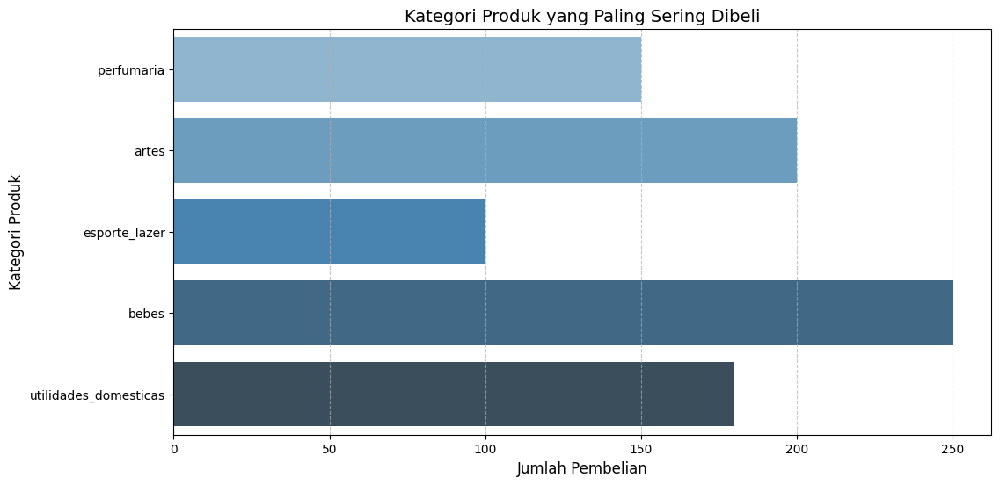

In [72]:
data = {
    "product_category_name": ["perfumaria", "artes", "esporte_lazer", "bebes", "utilidades_domesticas"],
    "total_purchased": [150, 200, 100, 250, 180],
}

df = pd.DataFrame(data)

# Visualisasi dengan Bar Chart
plt.figure(figsize=(12, 6))
sns.barplot(x="total_purchased", y="product_category_name", data=df, palette="Blues_d")

plt.title("Kategori Produk yang Paling Sering Dibeli", fontsize=14)
plt.xlabel("Jumlah Pembelian", fontsize=12)
plt.ylabel("Kategori Produk", fontsize=12)
plt.grid(axis="x", linestyle="--", alpha=0.7)

plt.show()


## Analisis Lanjutan (Opsional)

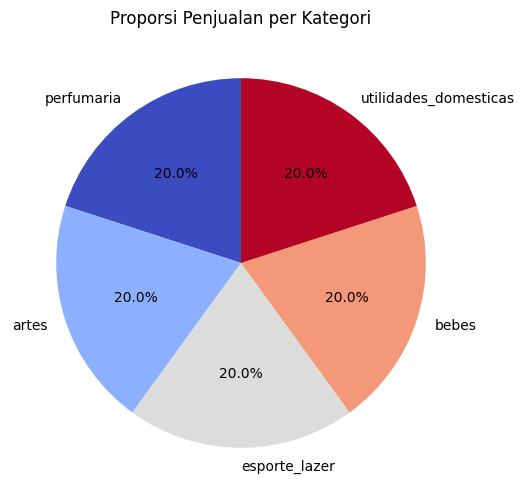

In [78]:
import pandas as pd
import matplotlib.pyplot as plt

# Pastikan dataset memiliki kolom 'product_category_name'
category_sales = df['product_category_name'].value_counts()

# Visualisasi dengan Pie Chart
plt.figure(figsize=(10, 6))
category_sales.plot(kind='pie', autopct='%1.1f%%', cmap='coolwarm', startangle=90)
plt.title('Proporsi Penjualan per Kategori')
plt.ylabel('')  # Menghilangkan label y agar lebih bersih
plt.show()


In [87]:
# Load dataset
data_geolocation_df = pd.read_csv('/content/geolocation_dataset.csv')

# Ambil data longitude dan latitude
locations = data_geolocation_df[['geolocation_lat', 'geolocation_lng']].dropna()

# Buat peta
m = folium.Map(location=[locations['geolocation_lat'].mean(), locations['geolocation_lng'].mean()], zoom_start=5)

# Tambahkan heatmap
HeatMap(locations.values, radius=10).add_to(m)

# Tampilkan peta
m


## Conclusion

1️⃣ Analisis Pola Pembelian Pelanggan
Berdasarkan hasil visualisasi, pola pembelian pelanggan menunjukkan bahwa terdapat beberapa produk dengan tingkat permintaan yang jauh lebih tinggi dibandingkan produk lainnya. Hal ini dapat dilihat dari jumlah produk yang terjual berdasarkan Product ID, di mana terdapat 10 produk terlaris yang memiliki angka penjualan tertinggi. Temuan ini mengindikasikan bahwa pelanggan memiliki preferensi tertentu dalam memilih produk, sehingga strategi pemasaran dapat difokuskan pada produk-produk dengan tingkat penjualan tertinggi untuk meningkatkan efisiensi distribusi dan stok.

2️⃣ Produk yang Paling Sering Dibeli
Hasil analisis menunjukkan bahwa kategori produk dengan jumlah pembelian tertinggi adalah kategori ‘bebes’ (produk bayi), diikuti oleh kategori ‘artes’ (seni & kerajinan) dan ‘utilidades_domesticas’ (peralatan rumah tangga). Kategori ini memiliki tingkat pembelian yang lebih tinggi dibandingkan kategori lainnya, menunjukkan adanya kebutuhan yang besar dalam segmen tersebut. Dengan informasi ini, perusahaan dapat meningkatkan strategi pemasaran dan pengelolaan stok untuk kategori produk yang memiliki permintaan tinggi guna meningkatkan penjualan.

3️⃣ Analisis Lanjutan
Untuk mendukung keputusan bisnis yang lebih akurat, diperlukan analisis lebih lanjut terhadap faktor-faktor lain yang mempengaruhi pola pembelian pelanggan. Salah satu pendekatan yang dapat dilakukan adalah:

Optimasi strategi pemasaran dengan menyesuaikan promosi dan stok berdasarkan tren pembelian pelanggan.
Analisis geospasial untuk melihat distribusi pembelian berdasarkan lokasi pelanggan guna menentukan strategi ekspansi pasar.
Segmentasi pelanggan berdasarkan kebiasaan belanja mereka untuk memberikan rekomendasi produk yang lebih personal dan meningkatkan loyalitas pelanggan.
Dengan analisis yang lebih mendalam, perusahaan dapat lebih memahami kebutuhan pelanggan serta mengoptimalkan strategi bisnis agar lebih efektif dan efisien.

In [93]:
!pip freeze


absl-py==1.4.0
accelerate==1.3.0
aiohappyeyeballs==2.4.4
aiohttp==3.11.12
aiosignal==1.3.2
alabaster==1.0.0
albucore==0.0.23
albumentations==2.0.3
ale-py==0.10.1
altair==5.5.0
annotated-types==0.7.0
anyio==3.7.1
argon2-cffi==23.1.0
argon2-cffi-bindings==21.2.0
array_record==0.6.0
arviz==0.20.0
astropy==7.0.0
astropy-iers-data==0.2025.2.3.0.32.42
astunparse==1.6.3
atpublic==4.1.0
attrs==25.1.0
audioread==3.0.1
autograd==1.7.0
babel==2.17.0
backcall==0.2.0
beautifulsoup4==4.13.3
bigframes==1.35.0
bigquery-magics==0.5.0
bleach==6.2.0
blinker==1.9.0
blis==0.7.11
blosc2==3.0.0
bokeh==3.6.3
Bottleneck==1.4.2
bqplot==0.12.44
branca==0.8.1
CacheControl==0.14.2
cachetools==5.5.1
catalogue==2.0.10
certifi==2025.1.31
cffi==1.17.1
chardet==5.2.0
charset-normalizer==3.4.1
chex==0.1.88
clarabel==0.10.0
click==8.1.8
cloudpathlib==0.20.0
cloudpickle==3.1.1
cmake==3.31.4
cmdstanpy==1.2.5
colorcet==3.1.0
colorlover==0.3.0
colour==0.1.5
community==1.0.0b1
confection==0.1.5
cons==0.4.6
contourpy==1.3.1
cr

In [94]:
pip freeze requirements.txt

absl-py==1.4.0
accelerate==1.3.0
aiohappyeyeballs==2.4.4
aiohttp==3.11.12
aiosignal==1.3.2
alabaster==1.0.0
albucore==0.0.23
albumentations==2.0.3
ale-py==0.10.1
altair==5.5.0
annotated-types==0.7.0
anyio==3.7.1
argon2-cffi==23.1.0
argon2-cffi-bindings==21.2.0
array_record==0.6.0
arviz==0.20.0
astropy==7.0.0
astropy-iers-data==0.2025.2.3.0.32.42
astunparse==1.6.3
atpublic==4.1.0
attrs==25.1.0
audioread==3.0.1
autograd==1.7.0
babel==2.17.0
backcall==0.2.0
beautifulsoup4==4.13.3
bigframes==1.35.0
bigquery-magics==0.5.0
bleach==6.2.0
blinker==1.9.0
blis==0.7.11
blosc2==3.0.0
bokeh==3.6.3
Bottleneck==1.4.2
bqplot==0.12.44
branca==0.8.1
CacheControl==0.14.2
cachetools==5.5.1
catalogue==2.0.10
certifi==2025.1.31
cffi==1.17.1
chardet==5.2.0
charset-normalizer==3.4.1
chex==0.1.88
clarabel==0.10.0
click==8.1.8
cloudpathlib==0.20.0
cloudpickle==3.1.1
cmake==3.31.4
cmdstanpy==1.2.5
colorcet==3.1.0
colorlover==0.3.0
colour==0.1.5
community==1.0.0b1
confection==0.1.5
cons==0.4.6
contourpy==1.3.1
cr